In [1]:
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

import matplotlib.pyplot as plt
%matplotlib inline

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from stop_words import get_stop_words

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly as py
import plotly.graph_objs as go
init_notebook_mode(connected=True)  

import re

In [2]:
df = pd.read_pickle('_outputs/harassement_clean_french.pickle')

In [3]:
len(df)

184885

### Main usernames

In [4]:
df.username_tweet.value_counts()[:20]

sex_abuse_news     2595
echoservicefr       711
JrmieJ              495
LettreAudio         461
Limportant_fr       460
MiKohiyama          347
Esperance_87        342
gridindriing        333
PAGNIERMickael      319
GG_RMC              310
MinouChrystayl      304
limportante_fr      269
DanielBrobecker     266
W38777Y             254
WCM_JustSocial      243
MagazineCheek       223
ILeonus             200
lesinrocks          199
liviscobal          194
GetchTchern         186
Name: username_tweet, dtype: int64

In [5]:
# sex_abuse_news : Bot Monitoring sexual abuses crimes
# echoservicefr : Bot qui n'a rien avoir
# JrmieJ : Bot qui n'a rien avoir

# Limportant_fr : presse
# LettreAudio : journaliste
# MiKohiyama : Présidente de l'association MoiAussiAmnesie.
# Esperance_87 : Présidente de cette asso d’aide auxfemmes victimes d’agressions sexuelles ds l’Eglise

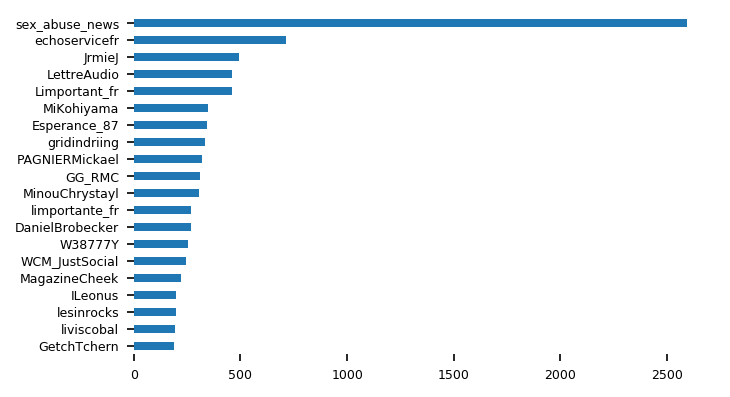

In [6]:
fig, ax = plt.subplots()
fig.dpi = 150
fig.set_size_inches(5, 3)
ax = df.username_tweet.value_counts()[:20].iloc[::-1].plot(kind='barh')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.tick_params(axis = 'both', labelsize = 6)
plt.show()

### Remove bots

In [7]:
df = df[df.username_tweet != 'sex_abuse_news']
df = df[df.username_tweet != 'echoservicefr']
df = df[df.username_tweet != 'JrmieJ']

In [8]:
len(df)

181084

### Save version with no bots

In [9]:
df.to_pickle('_outputs/harassement_clean_french_no_bots.pickle')

### Nbr favorites and retweets

In [10]:
df.sort_values(by=['nbr_favorite'], ascending=False)[['username_tweet', 'nbr_favorite', 'url', 'text']].head(10)

,username_tweet,nbr_favorite,url,text
5892,xoxoClementine,14276,/xoxoClementine/status/1190350452103110656,Cet homme a tenté de m’agresser sexuellement à...
198366,Maarie_R,7117,/Maarie_R/status/919344874578677761,"Sur #balancetonporc bcp de ""on va apprendre a..."
118373,redsunnysoul,7083,/redsunnysoul/status/1032253747072827392,Sur balancetonporc on dénonçait des hommes d...
2159,RaphyEnthoven,6470,/RaphyEnthoven/status/1194697213378809857,"Comme je le craignais, MeToo et les accusati..."
118315,Tinkerbell_ring,5243,/Tinkerbell_ring/status/1032285292068265985,"# BalanceTonPorc , ce sont tous les mecs qui t..."
197948,LBAP_coaching,5241,/LBAP_coaching/status/919408170069581824,# balancetonporc Beaucoup disent avoir peur p...
106522,LaPvlga,5154,/LaPvlga/status/1174961219607781377,Twitter ça n’apporte rien ptdrrr ? #balanceton...
187477,Pari_menagere,4770,/Pari_menagere/status/919619749583249408,"Si tu parles pas, ÇA NE VA PAS.\nSi tu parles ..."
56067,marielaguerre_,4632,/marielaguerre_/status/1023215727472455681,"Parce que j'ai répondu à son harcèlement, un h..."
164750,Chap_GG,4547,/Chap_GG/status/921267937364856832,"# BalanceTonPorc J'étais dans son lit, il eta..."


In [11]:
df.sort_values(by=['nbr_retweet'], ascending=False)[['username_tweet', 'nbr_retweet', 'url', 'text']].head(10)

,username_tweet,nbr_retweet,url,text
5892,xoxoClementine,25335,/xoxoClementine/status/1190350452103110656,Cet homme a tenté de m’agresser sexuellement à...
147278,MaximeHaes,5240,/MaximeHaes/status/932694300638482432,– Chômage : l’islam.\n– Changement climatique ...
82724,paul_denton,4844,/paul_denton/status/951204414878027782,"Ce moment où Brigitte Lahaie balance ""On peut ..."
198366,Maarie_R,4672,/Maarie_R/status/919344874578677761,"Sur #balancetonporc bcp de ""on va apprendre a..."
189480,ManonDrv,4134,/ManonDrv/status/919585168276492288,"📌 La différence entre drague et harcèlement, c..."
118373,redsunnysoul,3765,/redsunnysoul/status/1032253747072827392,Sur balancetonporc on dénonçait des hommes d...
2159,RaphyEnthoven,3444,/RaphyEnthoven/status/1194697213378809857,"Comme je le craignais, MeToo et les accusati..."
141753,SyriaCharity,3416,/SyriaCharity/status/941063530673065984,Fouzia a vu ses filles se faire violer puis tu...
197948,LBAP_coaching,3399,/LBAP_coaching/status/919408170069581824,# balancetonporc Beaucoup disent avoir peur p...
56067,marielaguerre_,3278,/marielaguerre_/status/1023215727472455681,"Parce que j'ai répondu à son harcèlement, un h..."


In [12]:
# xoxoClementine : dénonce un homme qui l'aurait agréssée dans le métro
# MaximeHaes : porte parole d'association homosexuelle (tweet de récupération - islam)
# paul_denton : Journaliste à 20 Minutes :  Brigitte Lahaie balance "On peut jouir lors d'un viol"
# Maarie_R : Muséologie ... à québec : Sur #balancetonporc bcp de "on va apprendre aux filles à se battre" mais pas "on va apprendre aux mecs à être normaux". Cherchez l'erreur.
# redsunnysoul : féministe enragée : Sur balancetonporc on dénonçait des hommes dangereux, des agresseurs, des pervers. Sur #balancetapouffe vous racontez juste vos râteaux et vos histoires de cul, vous vous discréditez vous même c'est beau à voir.
# RaphyEnthoven : compte parodique : Comme je le craignais, MeToo et les accusations de viols brisent des vies et des carrières.

### Number of tweets over time

In [13]:
tweetsT = df['datetime']
trace = go.Histogram(x=tweetsT,marker=dict(color='blue'),opacity=0.75)
layout = go.Layout(height=450,width=1000,xaxis=dict(title='Date'),yaxis=dict(title='Number of tweets'),bargap=0.2,)
data_total = [trace]
fig_time_total = go.Figure(data=data_total, layout=layout)

In [14]:
%%capture
layout = go.Layout(height=450,width=1000,xaxis=dict(title='Date'),yaxis=dict(title='Number of tweets'),bargap=0.2,)
fig_time_total = go.Figure()
fig_time_total.add_trace(go.Histogram(x=df['datetime'],marker=dict(color='blue'),opacity=0.75))
fig_time_total.add_annotation(dict(x="2017-10-13",y=60,text="1")) # 13 Oct 2017
fig_time_total.add_annotation(dict(x="2018-1-9",y=60,text="2")) # 09 Jan 2018
fig_time_total.add_annotation(dict(x="2018-3-6",y=60,text="3")) # 06 Mars 2018
fig_time_total.add_annotation(dict(x="2018-8-21",y=60,text="4")) # 21 Aout 2018
fig_time_total.add_annotation(dict(x="2018-10-3",y=60,text="5")) # 03 Oct 2018
fig_time_total.add_annotation(dict(x="2019-5-28",y=60,text="6")) # 28 May 2019
fig_time_total.add_annotation(dict(x="2019-9-25",y=60,text="7")) # 25 Sept 2019
fig_time_total.add_annotation(dict(x="2019-10-3",y=60,text="8")) # 03 Oct 2019 
fig_time_total.add_annotation(dict(x="2019-11-7",y=60,text="9")) # # 07 Nov 2019
fig_time_total.update_annotations(dict(xref="x",yref="y",ax=0,ay=-80))
fig_time_total.update_layout(showlegend=False)

In [15]:
# images dynamiques non visibles sur github - rendu statique ci-après
fig_time_total.show()

1. 13 Oct 2017 : #BalanceTonPorc Movement started
2. 09 Jan 2018 : Catherine Deneuve: ‘liberté d’importuner’
3. 06 Mars 2018 : Sandra Muller: la créatrice de #balancetonporc se bat pour conserver le nom de la marque (à l’Institut national de la propriété intellectuelle (INPI)
4. 21 Aout 2018 : Asia Argento scandal (elle était une figure du mouvement et se retrouve en position d'accusée) 
5. 03 Oct 2018 : Après un an du mouvement, des plaignantes désormais accusées
6. 28 May 2019 : Sandra Muller : La créatrice de #balancetonporc jugée pour diffamation après avoir accusé l’ex-patron d'Equidia de harcèlement sexuel
7. 25 Sept 2019 : Sandra Muller : Condamnée pour diffamation
8. 03 Oct 2019 : L’actrice Adèle Haenel accuse le réalisateur Christophe Ruggia d’harcèlement sexuel
9. 07 Nov 2019 : Des accusations dans des plateaux télévisés

### Nuage de Mots

In [16]:
text = " ".join(str(text) for text in df.clean_text)

In [17]:
stopwords = set()
stopwords.update(STOPWORDS) # stop en anglais
fr_stop_words = get_stop_words('fr') # stop en français
stopwords.update(fr_stop_words)
my_stop_words = ['balance', 'ton', 'porc', 'metoo', 'balancetonporc', 'hashtag', 'après', 'bien', 'via']
stopwords.update(my_stop_words)

In [18]:
wordcloud = WordCloud(stopwords=stopwords, max_words=100, background_color="white").generate(text)

(-0.5, 399.5, 199.5, -0.5)

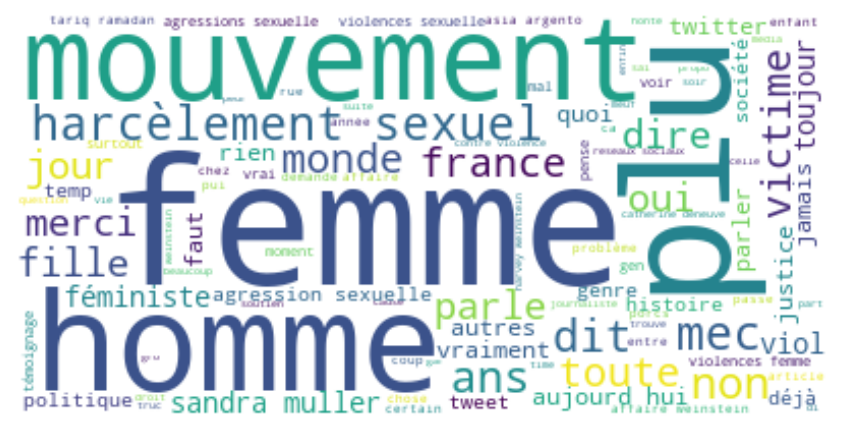

In [19]:
fig, ax = plt.subplots()
fig.dpi = 150
fig.set_size_inches(7, 5)
ax = plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### Tweets en rapport avec les transports

In [20]:
is_transport = lambda x : True if re.search(r'\bm[eé]tro\b|\brer\b|\btram\b|\bbus\b|\btransports?\b|\bvagons?\b|\bgares?\b|\brames?\b|\btransilien?\b|\bratp\b|\bsncf\b', x) else False

In [21]:
df_transports = df[df.clean_text.apply(is_transport)]

In [22]:
df_transports.head(2)

,index,username_tweet,id,text,url,nbr_retweet,nbr_favorite,nbr_reply,datetime,has_media,is_reply,is_retweet,is_quote,user_id,clean_text,lang
646,736,Ambrine_B,1198247919285088257,"J'ai dû remonter toute la manif, elle est imme...",/Ambrine_B/status/1198247919285088257,0,2,1,2019-11-23 15:32:20,NaN,0,0,0,347972472,remonter toute manif elle est immense olala mi...,fr
652,742,AudreyHarelLRSY,1198244390122278912,"J'ai été touchée dans le métro, dans la rue. J...",/AudreyHarelLRSY/status/1198244390122278912,1,2,0,2019-11-23 15:18:19,NaN,0,0,0,2338686942,été touchée dans métro dans rue été suivie ins...,fr


In [23]:
len(df_transports)

2480

In [24]:
df_transports.to_pickle('_outputs/harassement_clean_french_no_bots_transports.pickle')

### Nuage de mots sur les transports

In [25]:
text_new = " ".join(str(text) for text in df_transports.clean_text)

In [26]:
transport_stop_words = ['métro', 'tram', 'rer', 'bus', 'metro', 'transports', 'transport', 'gare', 'sncf', 'rame']
autres_stop_words = ['mec', 'mecs', 'homme', 'hommes', 'femme', 'femmes', 'meuf', 'ans', 'gars', 'fille', 'type', 'rue', 'bien', 'dit', 'etc', 'plus', 'via']
stopwords.update(transport_stop_words)
stopwords.update(autres_stop_words)

In [27]:
wordcloud = WordCloud(stopwords=stopwords, max_words=100, background_color="white").generate(text_new)

(-0.5, 399.5, 199.5, -0.5)

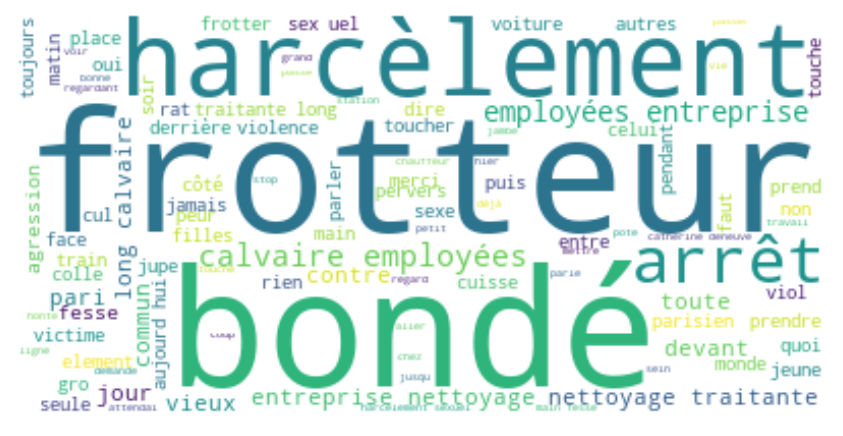

In [28]:
fig, ax = plt.subplots()
fig.dpi = 150
fig.set_size_inches(7, 5)
ax = plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### Number of tweets over time with transport references

In [29]:
%%capture
layout = go.Layout(height=450,width=1000,xaxis=dict(title='Date'),yaxis=dict(title='Number of tweets'),bargap=0.2,)
fig_time_transports = go.Figure()
fig_time_transports.add_trace(go.Histogram(x=df_transports['datetime'],marker=dict(color='blue'),opacity=0.75))
fig_time_transports.add_annotation(dict(x="2018-3-5",y=60,text="Première campagne"))
fig_time_transports.add_annotation(dict(x="2019-1-19",y=60,text="Deuxième campagne"))
fig_time_transports.update_annotations(dict(xref="x",yref="y",ax=0,ay=-80))
fig_time_transports.update_layout(showlegend=False)

In [30]:
# images dynamiques non visibles sur github - rendu statique ci-après
fig_time_transports.show()

Deux campagnes de lutte contre le harcèlement dans les transports.
5 mars 2108 et 18 janv. 2019

In [31]:
# images dynamiques non visibles sur github - rendu statique ci-après
fig_time_total.show()

### Rendu statique pour GitHub

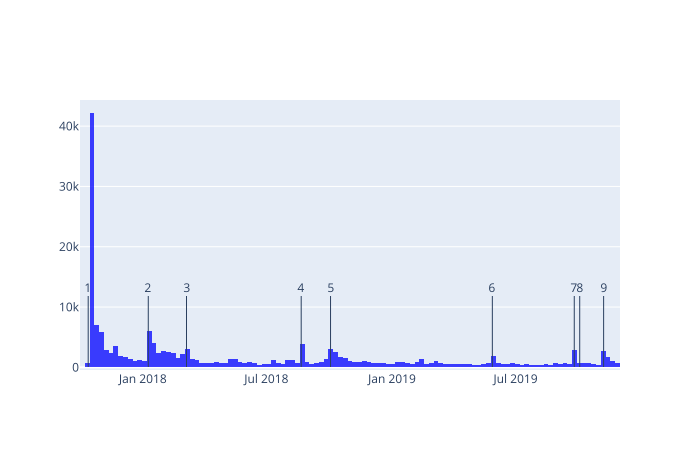

In [32]:
fig_time_total.show("svg")

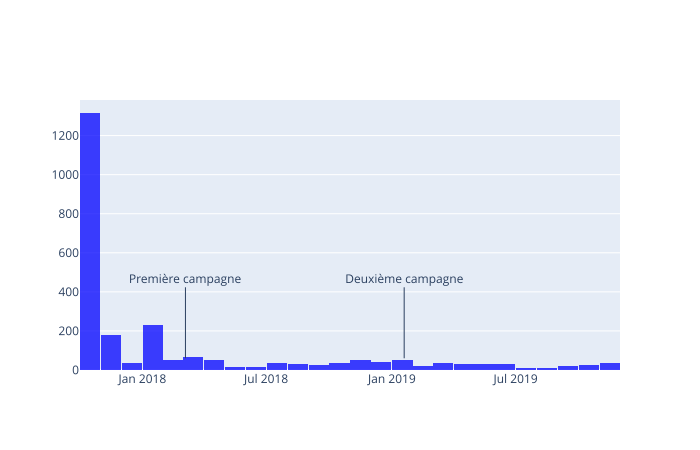

In [33]:
fig_time_transports.show("svg")